In [1]:
import sys
from pathlib import Path
import os
from time import perf_counter

In [2]:
project_working_dir = str(Path(sys.path[0]).parent)
sys.path += [project_working_dir]
os.chdir(project_working_dir)

In [3]:
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
from IPython.display import Image

In [4]:
%matplotlib inline

In [5]:
init_notebook_mode(connected=True);

In [6]:
from src.utils.file_io import read_json
from src.utils.read_obj import parse_obj

from src.display.show_pieces_2d import show_pattern
from src.display.show_avatar import show_each_mesh_different_colors
from src.display.common import plot_line_collection
from src.display.show_simulation_scatter import show_3d_scatter_simulation

from src.simulation.setup.extract_clothing_vertex_data import extract_all_piece_vertices
from src.simulation.mesh import create_mesh_line_collection
from src.simulation.simulation import FabricSimulation

In [7]:
from src.parameters import AVATAR_SCALING, NR_STEPS

In [8]:
clothing_data = read_json('./assets/sewing_shirt.json')

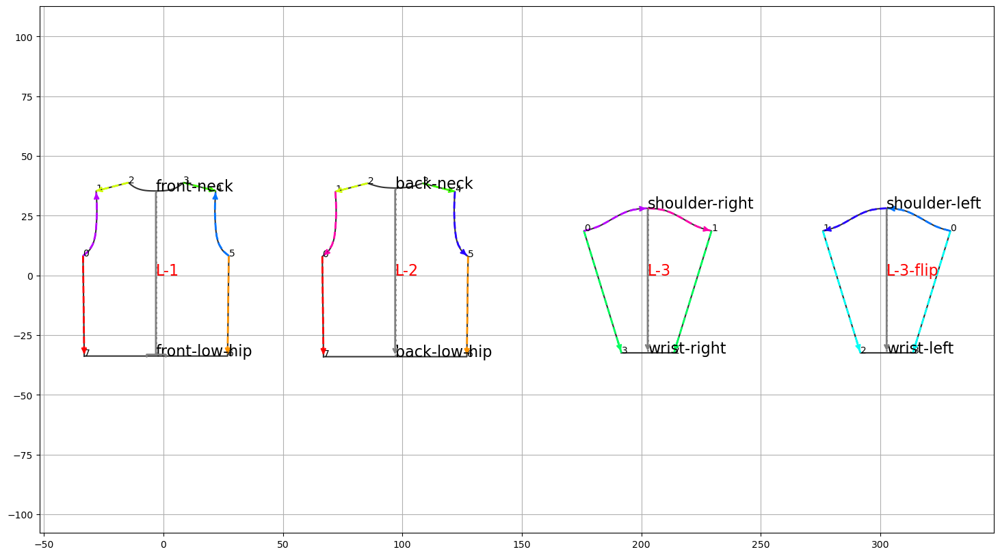

In [9]:
plt.figure(figsize=(18, 10))
show_pattern(clothing_data, (100, 0));

In [10]:
avatar_mesh = parse_obj('./assets/BodyMesh.obj', './assets/BodyAnnotations.json')
avatar_mesh.scale_vertices(AVATAR_SCALING)

In [11]:
dynamic_pieces, sewing_forces = extract_all_piece_vertices(clothing_data, avatar_mesh)

In [12]:
show_each_mesh_different_colors(avatar_mesh, dynamic_pieces, sewing_forces);

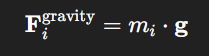

In [13]:
Image("./profiling/images/Screenshot 2025-05-17 182224.png")

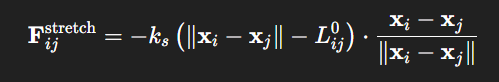

In [14]:
Image("./profiling/images/Screenshot 2025-05-17 182237.png")

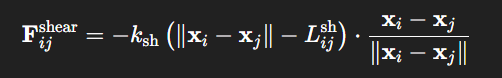

In [15]:
Image("./profiling/images/Screenshot 2025-05-17 182249.png")

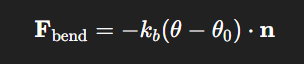

In [16]:
Image("./profiling/images/Screenshot 2025-05-17 182342.png")

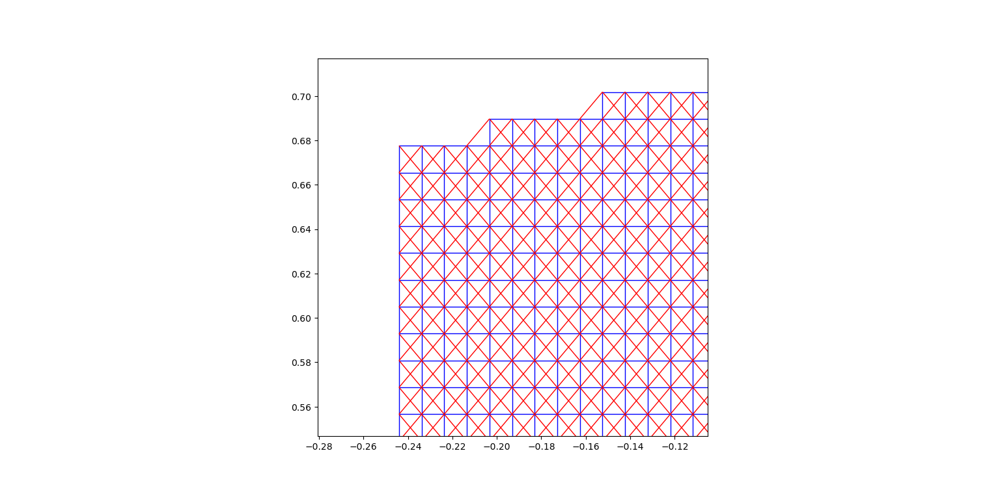

In [17]:
Image("./profiling/images/StressAndShearCloseUp.png")

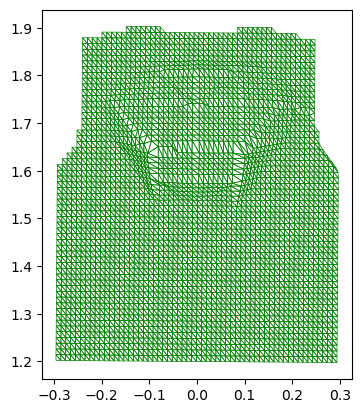

In [18]:
mesh = dynamic_pieces["L-2"].mesh
line_collection = create_mesh_line_collection(mesh, colors='green', linewidths=0.5)
plot_line_collection(line_collection)

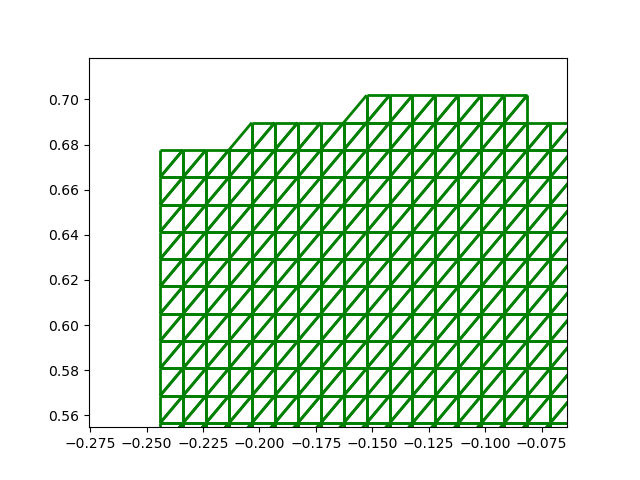

In [19]:
Image("./profiling/images/TrianglesCloseUp.png")

In [20]:
start = perf_counter()
simulation = FabricSimulation(avatar_mesh, dynamic_pieces, sewing_forces)
simulation.step(NR_STEPS, logging=False)
end = perf_counter()

In [21]:
show_3d_scatter_simulation(simulation)

In [22]:
print(f"Time taken {(end - start)/60:.1f} minutes")

Time taken 8.3 minutes
